# 3. Обработка пленоптических фотографий

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


Данное задание состоит двух основных частей. **Оно не является конкурсным**, за каждое подзадание можно получить максимальное качество баллов за приемлемую работу. Интересные мысли и красивая реализация приветствуются.

## Часть 1. Lytro Light Field Camera (8 баллов)

![plenoptic_small.jpg](plenoptic_small.jpg)

В 2011 году появилась камера Lytro Light Field Camera. Вот краткое описание формата пикселей:
* Базовое разрешение 3280x3280
* Линзы в массиве упакованы "как соты" (поэтому каждый второй ряд на полпикселя сдвинут относительно другого)
* Под каждой линзой количество пикселей по высоте и ширине не является целым
* Более того, этот массив микролинз немного повёрнут относительно массива пикселей

В этой части задания мы попробуем руками получить хоть что-то красивое из сырых изображений, а также научимся сдвигать наблюдателя в плоскости объектива

**Для начала откроем изображение**

In [ ]:
import skimage.io
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import HTML
from IPython.display import Image as ImageDisplay
from tqdm import tqdm_notebook
from tqdm import trange
import imageio
image = skimage.io.imread('drive/MyDrive/bee.png')
image = image / image.max()

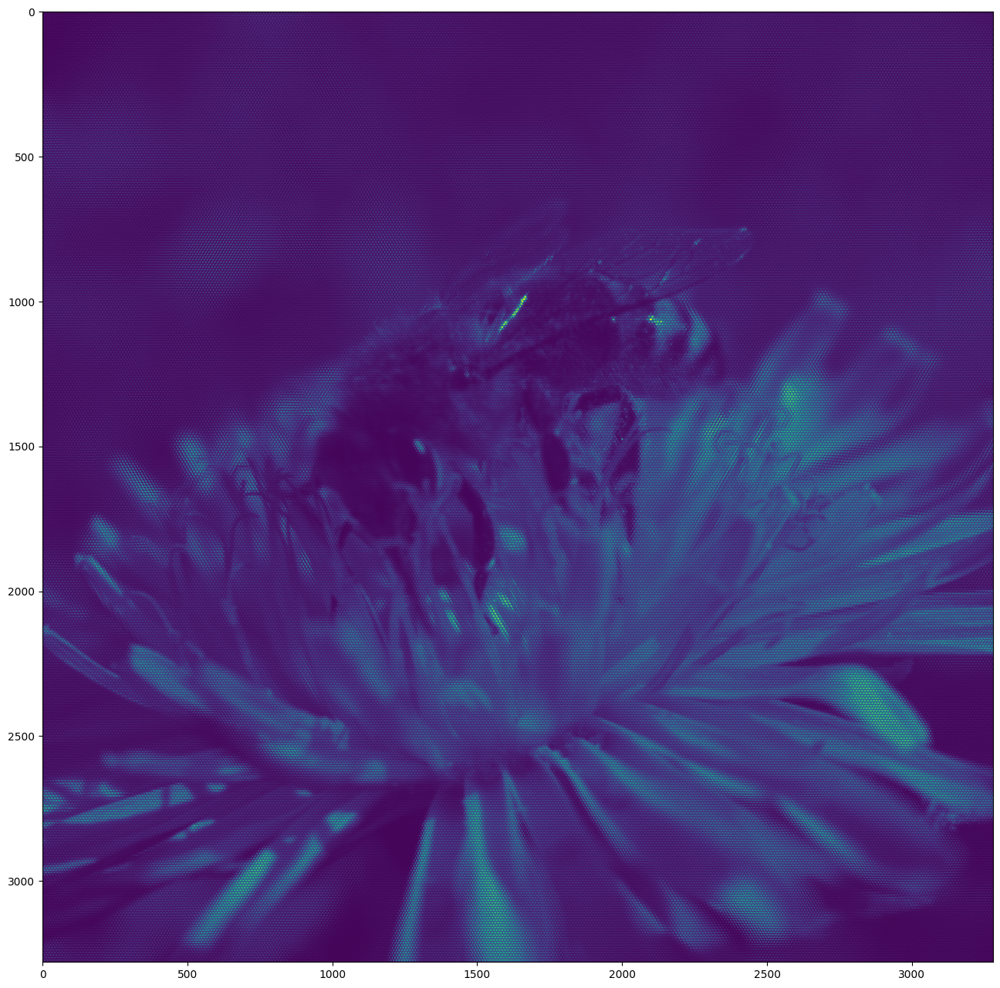

In [ ]:
image_array = np.array(image)
plt.figure(figsize=(16, 16))
plt.imshow(image_array)
plt.show()

Увеличим его часть:

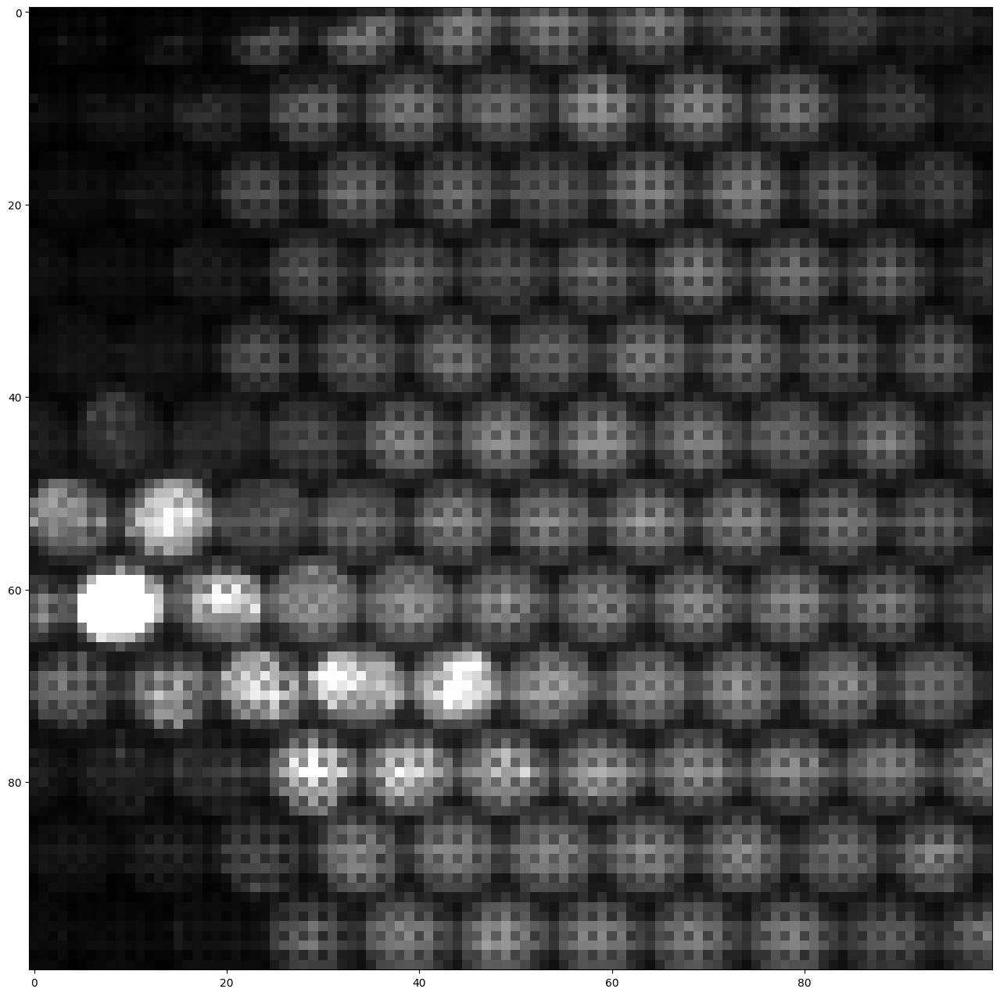

In [ ]:
image_array = np.array(image)
plt.figure(figsize=(16, 16))
plt.imshow(image_array[1000:1100, 2090:2190], cmap='gray')
plt.show()

Чётко прослеживается структура массива линз, кроме того, видим, что и внутри линз есть своя структура - некоторые пиксели регулярно темнее/светлее остальных. Дело в том, что изначально каждый фотодиод фотоматрицы принимает только определённый цвет изображения, так как [накрыт цветным фильтром](https://ru.wikipedia.org/wiki/%D0%A4%D0%B8%D0%BB%D1%8C%D1%82%D1%80_%D0%91%D0%B0%D0%B9%D0%B5%D1%80%D0%B0).

Преобразуем сырые данные камеры в RGB-изображение. Для этого:
* Составим маску красных, синих и зелёных каналов на сыром изображении
* Произведём интерполяцию путём усреднения соседних известных значений канала

Первый шаг - составление маски. Начиная с левого верхнего угла, цвет хранится так:
<table><tr><td bgcolor="#0000FF"></td><td bgcolor="#00FF00"></td></tr><tr><td bgcolor="#00FF00"></td><td bgcolor="#FF0000"></td></tr></table>
Напишите функцию, которая по заданной высоте и ширине изображения составит маски каналов (4 матрицы, значение элемента внутри которых равно единице в пикселях, который содержит B, G1, G2 или R компоненту соответственно).
Например, для изображения $2x2$ матрица для цветовой компоненты B выглядит так:
$$ \quad
\begin{pmatrix}
1 & 0 \\
0 & 0
\end{pmatrix}
\quad $$

Обратите внимание, что G-канал разделён на два для последующего удобства обработки.

In [ ]:
# Подзказка: объявите массивы-маски 2x2 и затем используйте np.tile
# В Lytro формат цвета такой
# B G1
# G2 R
def get_bayer_pattern_masks(height, width):
    '''
    Возвращает 4 маски заданной высоты и ширины для сырого изображения формата
    B G1
    G2 R
    :param h: int, height of bayer pattern
    :param w: int, width of bayer pattern
    :return [numpy.ndarray((h, w)), numpy.ndarray((h, w)), numpy.ndarray((h, w)), numpy.ndarray((h, w))]
    маски для B-компоненты, G1-компоненты, G2-компоненты и R-компоненты
    '''
    # YOUR CODE
    h = (int)(height / 2)
    w = (int)(width / 2)
    B = np.array([[1, 0], [0, 0]])
    G1 = np.array([[0, 1], [0, 0]])
    G2 = np.array([[0, 0], [1, 0]])
    R = np.array([[0, 0], [0, 1]])
    B = np.tile(B, (h, w))
    G1 = np.tile(G1, (h, w))
    G2 = np.tile(G2, (h, w))
    R = np.tile(R, (h, w))
    return [B, G1, G2, R]

Следующий шаг - интерполяция каналов. Действовать будем по [этой статье](https://www.researchgate.net/profile/Henrique-Malvar/publication/4087683_High-quality_linear_interpolation_for_demosaicing_of_Bayer-patterned_color_images/links/0fcfd50d1e1b44b180000000/High-quality-linear-interpolation-for-demosaicing-of-Bayer-patterned-color-images.pdf). Суть её заключается в том, что для каждого из четырёх типов пикселей мы вычисляем веса неизвестных каналов следующим способом:

![bayer_interpolation.png](bayer_interpolation.png)

In [ ]:
def high_quality_bayer_interpolation(start_raw_image):
    raw_image = start_raw_image.copy()
    h = raw_image.shape[0]
    w = raw_image.shape[1]
    weigths_0 = (1 / 8) * np.array([
        [ 0,  0, 1/2,  0,  0],
        [ 0, -1,   0, -1,  0],
        [-1,  4,   5,  4, -1],
        [ 0, -1,   0, -1,  0],
        [ 0,  0, 1/2,  0,  0]
    ])

    weigths_1 = (1 / 8) * np.array([
        [  0,  0,  -1,  0,   0],
        [  0, -1,   4, -1,   0],
        [1/2,  0,   5,  0, 1/2],
        [  0, -1,   4, -1,   0],
        [  0,  0,  -1,  0,   0]
    ])

    weigths_2 = (1 / 8) * np.array([
        [   0,  0, -3/2,  0,    0],
        [   0,  2,    0,  2,    0],
        [-3/2,  0,    6,  0, -3/2],
        [   0,  2,    0,  2,    0],
        [   0,  0, -3/2,  0,    0]
    ])

    weigths_3 = (1 / 8) * np.array([
        [ 0,  0, -1,  0,  0],
        [ 0,  0,  2,  0,  0],
        [-1,  2,  4,  2, -1],
        [ 0,  0,  2,  0,  0],
        [ 0,  0, -1,  0,  0]
    ])
    image = np.zeros((h, w, 3), dtype=np.float64)
    # mask_b, mask_g1, mask_g2, mask_r = get_bayer_pattern_masks(h, w)
    raw_image = raw_image.astype(np.float64)
    pas = np.zeros((h, 2))
    raw_image = np.hstack([pas, raw_image])
    pas = np.zeros((h, 2))
    raw_image = np.hstack([raw_image, pas])
    pas = np.zeros((2, w + 4))
    raw_image = np.vstack([pas, raw_image])
    pas = np.zeros((2, w + 4))
    raw_image = np.vstack([raw_image, pas])
    h += 4
    w += 4
   # YOUR CODE
    for i in trange(2, h - 2):
        for j in range(2, w - 2):
            matrix = raw_image[i - 2 : i + 3, j - 2 : j + 3]
            if i % 2 and j % 2:
                image[i - 2, j - 2, 1] = np.sum(matrix * weigths_3)
                image[i - 2, j - 2, 2] = np.sum(matrix * weigths_2)
                image[i - 2, j - 2 , 0] = matrix[2, 2]
            elif i % 2 and not j % 2:
                image[i - 2, j - 2, 0] = np.sum(matrix * weigths_0)
                image[i - 2, j - 2, 2] = np.sum(matrix * weigths_1)
                image[i - 2, j - 2, 1] = matrix[2, 2]
            elif not i % 2 and j % 2:
                image[i - 2, j - 2, 0] = np.sum(matrix * weigths_1)
                image[i - 2, j - 2, 2] = np.sum(matrix * weigths_0)
                image[i - 2, j - 2, 1] = matrix[2, 2]
            else:
                image[i - 2, j - 2, 0] = np.sum(matrix * weigths_2)
                image[i - 2, j - 2, 1] = np.sum(matrix * weigths_3)
                image[i - 2, j - 2, 2] = matrix[2, 2]
    return np.clip(image, 0, 1)

In [ ]:
image_interpolated = high_quality_bayer_interpolation(image_array)

100%|██████████| 3280/3280 [03:10<00:00, 17.19it/s]


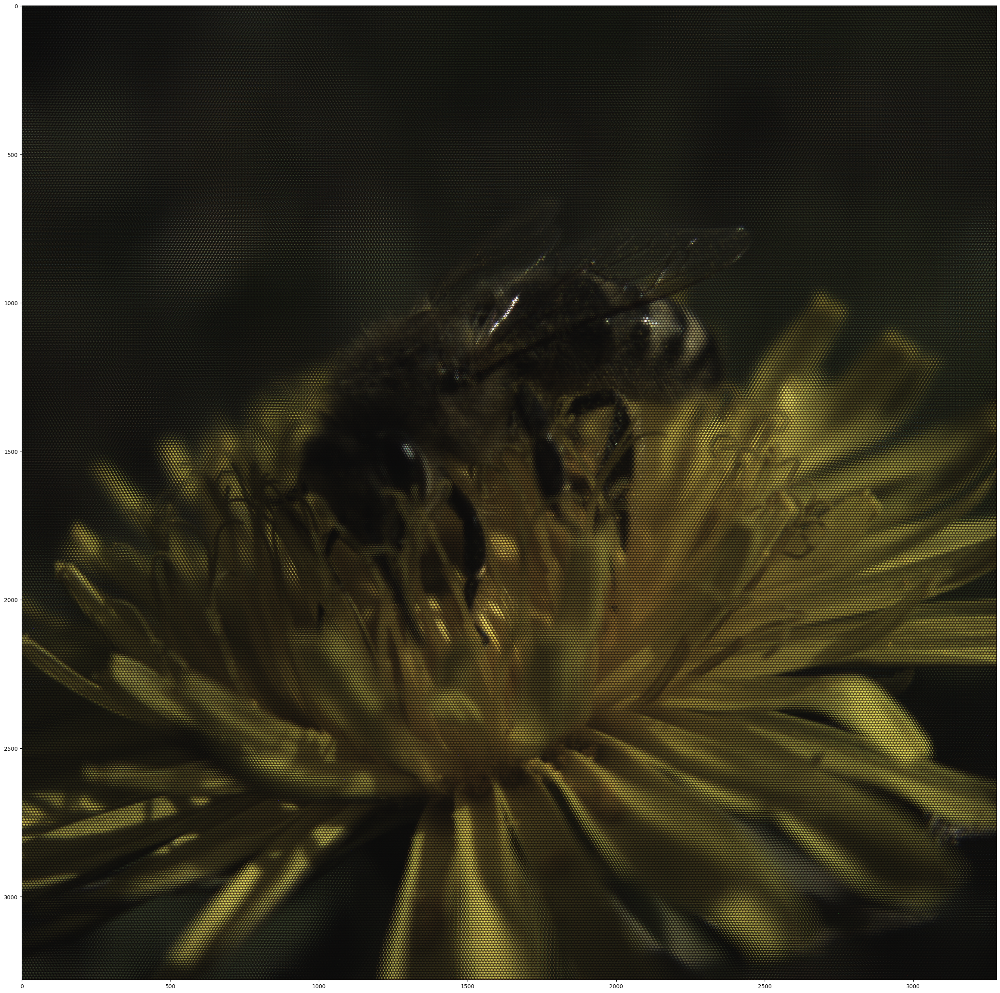

In [ ]:
plt.figure(figsize=(32, 32))
plt.imshow(image_interpolated)
plt.show()

**Ура!** Теперь осталось его правильно обработать. Давайте реализуем сдвиг по вертикали и горизонтали.

В простейшем случае процесс описан в [этой ссылке](http://www.plenoptic.info/pages/sub-aperture.html) (только параграф про получение Sub-apertures!). По сути, нужно выбрать пиксели внутри каждого блока с некоторым сдвигом

In [ ]:
plenoptic_image_config = {
    'block_width': 9.927582228653469,
    'block_height': 8.607538408172838
}

In [ ]:
second_row_shift = 0
first_row_shift = 5
def baseline_move(plenoptic_raw_image, plenoptic_image_config, position_shift_y, position_shift_x):
    y = position_shift_y + 3
    x = position_shift_x + 4
    raw_image_height = plenoptic_raw_image.shape[0]
    raw_image_width = plenoptic_raw_image.shape[1]
    block_height = plenoptic_image_config['block_height']
    block_width = plenoptic_image_config['block_width']
    block_count_h = int(raw_image_height // block_height)
    block_count_w = int(raw_image_width // block_width)
    result = np.zeros((block_count_h, block_count_w, 3))

    # Учтите, что высота линзы и её ширина не равна целому числу пикселей
    # поэтому не пренебрегайте использования магическими константами
    # (block_height - высота линзы, block_width - её ширина).
    # Также учтите, что каждый второй ряд сдвинут относительно первого.
    # Замечание: написать вложенные циклы тут ОК
    for i in range(0, block_count_h, 1):
      first = int(i * block_height) + y
      for j in range(0, block_count_w, 1):
        second = int(j * block_width) + x
        for k in range(3):
          result[i][j][k] = plenoptic_raw_image[first][second][k]

    return result

In [ ]:
images = []
for dx in tqdm_notebook(range(-4, 5, 1)):
    for dy in range(-3, 5, 1):
        image = baseline_move(image_interpolated, plenoptic_image_config, dy, dx)
        images.append(image)

<ipython-input-96-1ef4d26e58ee>:2: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for dx in tqdm_notebook(range(-4, 5, 1)):


  0%|          | 0/9 [00:00<?, ?it/s]

In [ ]:
output_file='baseline_move.gif'
import imageio
duration = 0.5
imageio.mimsave(output_file, images, duration=duration)

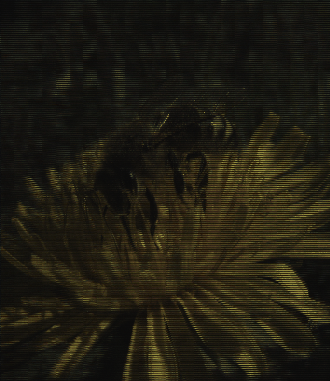

In [ ]:
with open('baseline_move.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='png'))

*Что ожидается увидеть: заметное движение заднего фона, однако, яркость изображений будет отличаться, это нормально. Кроме того, возможны небольшие горизонтальные/вертикальные полоски.*.

Несоответствие по яркости происходит из-за того, что через массив микролинз свет падает неравномерно на массив фотодиодов, а при дебайеринге мы никак не учитывали этот факт.
Попробуем отнормировать изображения по цвету. Для этого воспользуйтесь функцией [match_histograms](http://scikit-image.org/docs/dev/auto_examples/transform/plot_histogram_matching.html)


In [ ]:
second_row_shift = 0
first_row_shift = 5
def baseline_move_his(plenoptic_raw_image, plenoptic_image_config, position_shift_y, position_shift_x):
    y = position_shift_y + 3
    x = position_shift_x + 4
    raw_image_height = plenoptic_raw_image.shape[0]
    raw_image_width = plenoptic_raw_image.shape[1]
    block_height = plenoptic_image_config['block_height']
    block_width = plenoptic_image_config['block_width']
    block_count_h = int(raw_image_height // block_height)
    block_count_w = int(raw_image_width // block_width)
    result = np.zeros((block_count_h, block_count_w, 3))

    # Учтите, что высота линзы и её ширина не равна целому числу пикселей
    # поэтому не пренебрегайте использования магическими константами
    # (block_height - высота линзы, block_width - её ширина).
    # Также учтите, что каждый второй ряд сдвинут относительно первого.
    # Замечание: написать вложенные циклы тут ОК
    for i in range(0, block_count_h, 1):
      first = int(i * block_height) + y
      for j in range(0, block_count_w, 1):
        second = int(j * block_width) + x
        for k in range(3):
          result[i][j][k] = plenoptic_raw_image[first][second][k]

    return result

In [ ]:
from skimage.exposure import match_histograms

In [ ]:
images = []
# YOUR CODE

new_image = baseline_move_his(image_interpolated, plenoptic_image_config, 0, 0)
                          #  near
# for dy in tqdm_notebook(range(-3, -2, 1)):
#     for dx in range(-4, 5, 1):
#         image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
#         image = match_histograms(image, new_image)
#         # YOUR CODE
#         images.append(image)
# for dx in tqdm_notebook(range(4, 5, 1)):
#     for dy in range(-3, 5, 1):
#         image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
#         image = match_histograms(image, new_image)
#         # YOUR CODE
#         images.append(image)
# for dy in tqdm_notebook(range(4, 5, 1)):
#     for dx in range(4, -5, -1):
#         image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
#         image = match_histograms(image, new_image)
#         # YOUR CODE
#         images.append(image)
# for dx in tqdm_notebook(range(-4, -3, 1)):
#     for dy in range(4, -4, -1):
#         image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
#         image = match_histograms(image, new_image)
#         # YOUR CODE
#         images.append(image)
                              # Three
# for dy in tqdm_notebook(range(-3, -2, 1)):
#     for dx in range(-1, 2, 1):
#         image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
#         image = match_histograms(image, new_image)
#         # YOUR CODE
#         images.append(image)

# for i in range(1, 3):
#     image = baseline_move_his(image_interpolated, plenoptic_image_config, -3 + i, 1 + i)
#     image = match_histograms(image, new_image)
#         # YOUR CODE
#     images.append(image)

# for dx in tqdm_notebook(range(4, 5, 1)):
#     for dy in range(0, 3, 1):
#         image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
#         image = match_histograms(image, new_image)
#         # YOUR CODE
#         images.append(image)

# for i in range(1, 3):
#     image = baseline_move_his(image_interpolated, plenoptic_image_config, 1 + i, 4 - i)
#     image = match_histograms(image, new_image)
#         # YOUR CODE
#     images.append(image)

# for dy in tqdm_notebook(range(4, 5, 1)):
#     for dx in range(1, -2, -1):
#         image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
#         image = match_histograms(image, new_image)
#         # YOUR CODE
#         images.append(image)

# for i in range(1, 3):
#     image = baseline_move_his(image_interpolated, plenoptic_image_config, 4 - i, -1 - i)
#     image = match_histograms(image, new_image)
#         # YOUR CODE
#     images.append(image)

# for dx in tqdm_notebook(range(-4, -3, 1)):
#     for dy in range(1, -1, -1):
#         image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
#         image = match_histograms(image, new_image)
#         # YOUR CODE
#         images.append(image)

# for i in range(1, 3):
#     image = baseline_move_his(image_interpolated, plenoptic_image_config, -i, -4 + i)
#     image = match_histograms(image, new_image)
#         # YOUR CODE
#     images.append(image)

                        # One
for dy in tqdm_notebook(range(-3, -2, 1)):
    for dx in range(0, 1, 1):
        image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
        image = match_histograms(image, new_image)
        # YOUR CODE
        images.append(image)

for i in range(1, 4):
    image = baseline_move_his(image_interpolated, plenoptic_image_config, -3 + i, i)
    image = match_histograms(image, new_image)
        # YOUR CODE
    images.append(image)

for dx in tqdm_notebook(range(4, 5, 1)):
    for dy in range(0, 0, 1):
        image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
        image = match_histograms(image, new_image)
        # YOUR CODE
        images.append(image)

for i in range(1, 4):
    image = baseline_move_his(image_interpolated, plenoptic_image_config, i, 4 - i)
    image = match_histograms(image, new_image)
        # YOUR CODE
    images.append(image)

for dy in tqdm_notebook(range(4, 5, 1)):
    for dx in range(0, -1, -1):
        image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
        image = match_histograms(image, new_image)
        # YOUR CODE
        images.append(image)

for i in range(1, 4):
    image = baseline_move_his(image_interpolated, plenoptic_image_config, 4 - i, -i)
    image = match_histograms(image, new_image)
        # YOUR CODE
    images.append(image)

for dx in tqdm_notebook(range(-4, -3, 1)):
    for dy in range(0, 0, -1):
        image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
        image = match_histograms(image, new_image)
        # YOUR CODE
        images.append(image)

for i in range(1, 4):
    image = baseline_move_his(image_interpolated, plenoptic_image_config, 1 - i, -4 + i)
    image = match_histograms(image, new_image)
        # YOUR CODE
    images.append(image)

<ipython-input-102-9c68d2adc63f>:84: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for dy in tqdm_notebook(range(-3, -2, 1)):


  0%|          | 0/1 [00:00<?, ?it/s]

<ipython-input-102-9c68d2adc63f>:97: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for dx in tqdm_notebook(range(4, 5, 1)):


  0%|          | 0/1 [00:00<?, ?it/s]

<ipython-input-102-9c68d2adc63f>:110: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for dy in tqdm_notebook(range(4, 5, 1)):


  0%|          | 0/1 [00:00<?, ?it/s]

<ipython-input-102-9c68d2adc63f>:123: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for dx in tqdm_notebook(range(-4, -3, 1)):


  0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
output_file='baseline_move_with_histograms.gif'
duration = 0.11
imageio.mimsave(output_file, images, duration=duration)

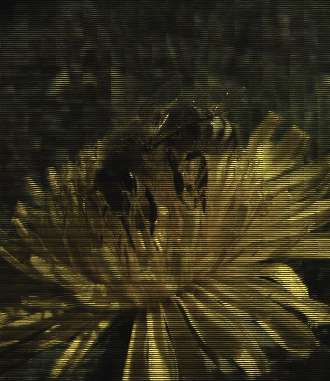

In [ ]:
with open('baseline_move_with_histograms.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

In [ ]:
second_row_shift = 0
first_row_shift = 5
def baseline_move_last(plenoptic_raw_image, plenoptic_image_config, position_shift_y, position_shift_x):
    y = position_shift_y + 3
    x = position_shift_x + 4
    raw_image_height = plenoptic_raw_image.shape[0]
    raw_image_width = plenoptic_raw_image.shape[1]
    block_height = plenoptic_image_config['block_height']
    block_width = plenoptic_image_config['block_width']
    block_count_h = int(raw_image_height // block_height)
    block_count_w = int(raw_image_width // block_width)
    result = np.zeros((block_count_h, block_count_w, 3))

    # Учтите, что высота линзы и её ширина не равна целому числу пикселей
    # поэтому не пренебрегайте использования магическими константами
    # (block_height - высота линзы, block_width - её ширина).
    # Также учтите, что каждый второй ряд сдвинут относительно первого.
    # Замечание: написать вложенные циклы тут ОК
    for i in range(0, block_count_h, 1):
      first = int(i * block_height) + y
      for j in range(0, block_count_w, 1):
        second = int(j * block_width) + x
        for k in range(3):
          result[i][j][k] = plenoptic_raw_image[first][second][k]

    return result

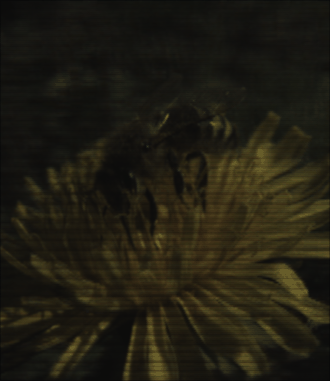

In [ ]:
images = []
for dy in range(-3, 5, 1):
    f_image = baseline_move_last(image_interpolated, plenoptic_image_config, dy, -4)
    s_image = baseline_move_last(image_interpolated, plenoptic_image_config, dy, 4)
    img = f_image + s_image
    img = np.array(img)
    im = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.float64)

    h = im.shape[0]
    w = im.shape[1]
    img = img.astype(np.float64)
    pas = np.zeros((h, 1, 3))
    img = np.hstack([pas, img])
    pas = np.zeros((h, 1, 3))
    img = np.hstack([img, pas])
    pas = np.zeros((1, w + 2, 3))
    img = np.vstack([pas, img])
    pas = np.zeros((1, w + 2, 3))
    img = np.vstack([img, pas])
    h += 2
    w += 2
    matrix = (1 / 22) * np.array([
            [1, 1, 1],
            [1, 3, 1],
            [1, 1, 1]
        ])
    for i in range(1, h - 1):
      for j in range(1, w - 1):
          for t in range(3):
            for p in range(3):
              im[i - 1, j - 1, 0] += img[i - 1 + t, j - 1 + p, 0] * matrix[t, p]
              im[i - 1, j - 1, 1] += img[i - 1 + t, j - 1 + p, 1] * matrix[t, p]
              im[i - 1, j - 1, 2] += img[i - 1 + t, j - 1 + p, 2] * matrix[t, p]

    images.append(im)

output_file='baseline_move_with_last_4.gif'
duration = 0.11
imageio.mimsave(output_file, images, duration=duration)

with open('baseline_move_with_last_4.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

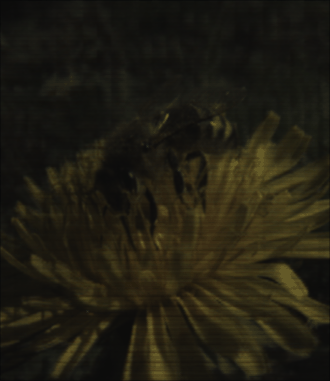

In [ ]:
images = []
for dy in range(-3, 5, 1):
    f_image = baseline_move_last(image_interpolated, plenoptic_image_config, dy, -3)
    s_image = baseline_move_last(image_interpolated, plenoptic_image_config, dy, 3)
    img = f_image + s_image
    img = np.array(img)
    im = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.float64)

    h = im.shape[0]
    w = im.shape[1]
    img = img.astype(np.float64)
    pas = np.zeros((h, 1, 3))
    img = np.hstack([pas, img])
    pas = np.zeros((h, 1, 3))
    img = np.hstack([img, pas])
    pas = np.zeros((1, w + 2, 3))
    img = np.vstack([pas, img])
    pas = np.zeros((1, w + 2, 3))
    img = np.vstack([img, pas])
    h += 2
    w += 2
    matrix = (1 / 22) * np.array([
            [1, 1, 1],
            [1, 3, 1],
            [1, 1, 1]
        ])
    for i in range(1, h - 1):
      for j in range(1, w - 1):
          for t in range(3):
            for p in range(3):
              im[i - 1, j - 1, 0] += img[i - 1 + t, j - 1 + p, 0] * matrix[t, p]
              im[i - 1, j - 1, 1] += img[i - 1 + t, j - 1 + p, 1] * matrix[t, p]
              im[i - 1, j - 1, 2] += img[i - 1 + t, j - 1 + p, 2] * matrix[t, p]

    images.append(im)

output_file='baseline_move_with_last_3.gif'
duration = 0.11
imageio.mimsave(output_file, images, duration=duration)

with open('baseline_move_with_last_3.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

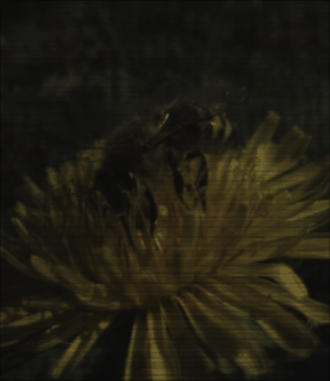

In [ ]:
images = []
for dy in range(-3, 5, 1):
    f_image = baseline_move_last(image_interpolated, plenoptic_image_config, dy, -2)
    s_image = baseline_move_last(image_interpolated, plenoptic_image_config, dy, 2)
    img = f_image + s_image
    img = np.array(img)
    im = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.float64)

    h = im.shape[0]
    w = im.shape[1]
    img = img.astype(np.float64)
    pas = np.zeros((h, 1, 3))
    img = np.hstack([pas, img])
    pas = np.zeros((h, 1, 3))
    img = np.hstack([img, pas])
    pas = np.zeros((1, w + 2, 3))
    img = np.vstack([pas, img])
    pas = np.zeros((1, w + 2, 3))
    img = np.vstack([img, pas])
    h += 2
    w += 2
    matrix = (1 / 22) * np.array([
            [1, 1, 1],
            [1, 3, 1],
            [1, 1, 1]
        ])
    for i in range(1, h - 1):
      for j in range(1, w - 1):
          for t in range(3):
            for p in range(3):
              im[i - 1, j - 1, 0] += img[i - 1 + t, j - 1 + p, 0] * matrix[t, p]
              im[i - 1, j - 1, 1] += img[i - 1 + t, j - 1 + p, 1] * matrix[t, p]
              im[i - 1, j - 1, 2] += img[i - 1 + t, j - 1 + p, 2] * matrix[t, p]

    images.append(im)

output_file='baseline_move_with_last_2.gif'
duration = 0.11
imageio.mimsave(output_file, images, duration=duration)

with open('baseline_move_with_last_2.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

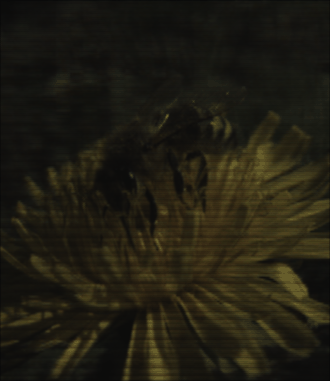

In [ ]:
images = []
for dy in range(-3, 5, 1):
    f_image = baseline_move_last(image_interpolated, plenoptic_image_config, dy, -1)
    s_image = baseline_move_last(image_interpolated, plenoptic_image_config, dy, 1)
    img = f_image + s_image
    img = np.array(img)
    im = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.float64)

    h = im.shape[0]
    w = im.shape[1]
    img = img.astype(np.float64)
    pas = np.zeros((h, 1, 3))
    img = np.hstack([pas, img])
    pas = np.zeros((h, 1, 3))
    img = np.hstack([img, pas])
    pas = np.zeros((1, w + 2, 3))
    img = np.vstack([pas, img])
    pas = np.zeros((1, w + 2, 3))
    img = np.vstack([img, pas])
    h += 2
    w += 2
    matrix = (1 / 22) * np.array([
            [1, 1, 1],
            [1, 3, 1],
            [1, 1, 1]
        ])
    for i in range(1, h - 1):
      for j in range(1, w - 1):
          for t in range(3):
            for p in range(3):
              im[i - 1, j - 1, 0] += img[i - 1 + t, j - 1 + p, 0] * matrix[t, p]
              im[i - 1, j - 1, 1] += img[i - 1 + t, j - 1 + p, 1] * matrix[t, p]
              im[i - 1, j - 1, 2] += img[i - 1 + t, j - 1 + p, 2] * matrix[t, p]

    images.append(im)

output_file='baseline_move_with_last_1.gif'
duration = 0.11
imageio.mimsave(output_file, images, duration=duration)

with open('baseline_move_with_last_1.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

Если параллакс уменьшать, визуально, качество картинки становится хуже (на картинке появляются полосы). Лучший результат был получен с максимальным параллаксом.

In [ ]:
def pas(img):
    img = np.array(img)
    im = np.zeros((img.shape[0], img.shape[1], 3), dtype=np.float64)

    h = im.shape[0]
    w = im.shape[1]
    img = img.astype(np.float64)
    pas = np.zeros((h, 1, 3))
    img = np.hstack([pas, img])
    pas = np.zeros((h, 1, 3))
    img = np.hstack([img, pas])
    pas = np.zeros((1, w + 2, 3))
    img = np.vstack([pas, img])
    pas = np.zeros((1, w + 2, 3))
    img = np.vstack([img, pas])
    h += 2
    w += 2
    matrix = (1 / 22) * np.array([
            [1, 1, 1],
            [1, 3, 1],
            [1, 1, 1]
        ])
    for i in range(1, h - 1):
      for j in range(1, w - 1):
          for t in range(3):
            for p in range(3):
              im[i - 1, j - 1, 0] += img[i - 1 + t, j - 1 + p, 0] * matrix[t, p]
              im[i - 1, j - 1, 1] += img[i - 1 + t, j - 1 + p, 1] * matrix[t, p]
              im[i - 1, j - 1, 2] += img[i - 1 + t, j - 1 + p, 2] * matrix[t, p]
    return im

In [ ]:
images = []
# YOUR CODE

new_image = pas(baseline_move_his(image_interpolated, plenoptic_image_config, 0, -4) + baseline_move_his(image_interpolated, plenoptic_image_config, 0, 4))

image = pas(baseline_move_his(image_interpolated, plenoptic_image_config, -3, 0) + baseline_move_his(image_interpolated, plenoptic_image_config, 0, 0))
image = match_histograms(image, new_image)
# YOUR CODE
images.append(image)

for i in range(1, 4):
    image = pas(baseline_move_his(image_interpolated, plenoptic_image_config, -3 + i, i) + baseline_move_his(image_interpolated, plenoptic_image_config, 0, 0))
    image = match_histograms(image, new_image)
        # YOUR CODE
    images.append(image)

for dx in tqdm_notebook(range(4, 5, 1)):
    for dy in range(0, 0, 1):
        image = baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx)
        image = match_histograms(image, new_image)
        # YOUR CODE
        images.append(image)

for i in range(1, 4):
    image = pas(baseline_move_his(image_interpolated, plenoptic_image_config, i, 4 - i) + baseline_move_his(image_interpolated, plenoptic_image_config, 1, 0))
    image = match_histograms(image, new_image)
        # YOUR CODE
    images.append(image)

for dy in tqdm_notebook(range(4, 5, 1)):
    for dx in range(0, -1, -1):
        image = pas(baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx) + baseline_move_his(image_interpolated, plenoptic_image_config, 1, 0))
        image = match_histograms(image, new_image)
        # YOUR CODE
        images.append(image)

for i in range(1, 4):
    image = pas(baseline_move_his(image_interpolated, plenoptic_image_config, 4 - i, -i) + baseline_move_his(image_interpolated, plenoptic_image_config, 1, 0))
    image = match_histograms(image, new_image)
        # YOUR CODE
    images.append(image)

for dx in tqdm_notebook(range(-4, -3, 1)):
    for dy in range(0, 0, -1):
        image = pas(baseline_move_his(image_interpolated, plenoptic_image_config, dy, dx) + baseline_move_his(image_interpolated, plenoptic_image_config, 1, 0))
        image = match_histograms(image, new_image)
        # YOUR CODE
        images.append(image)

for i in range(1, 4):
    image = pas(baseline_move_his(image_interpolated, plenoptic_image_config, 1 - i, -4 + i) + baseline_move_his(image_interpolated, plenoptic_image_config, 0, 0))
    image = match_histograms(image, new_image)
        # YOUR CODE
    images.append(image)

<ipython-input-111-a0ef06bedd3e>:17: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for dx in tqdm_notebook(range(4, 5, 1)):


  0%|          | 0/1 [00:00<?, ?it/s]

<ipython-input-111-a0ef06bedd3e>:30: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for dy in tqdm_notebook(range(4, 5, 1)):


  0%|          | 0/1 [00:00<?, ?it/s]

<ipython-input-111-a0ef06bedd3e>:43: TqdmDeprecationWarning: This function will be removed in tqdm==5.0.0
Please use `tqdm.notebook.tqdm` instead of `tqdm.tqdm_notebook`
  for dx in tqdm_notebook(range(-4, -3, 1)):


  0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
output_file='baseline_move_with_histograms_blur.gif'
duration = 0.11
imageio.mimsave(output_file, images, duration=duration)

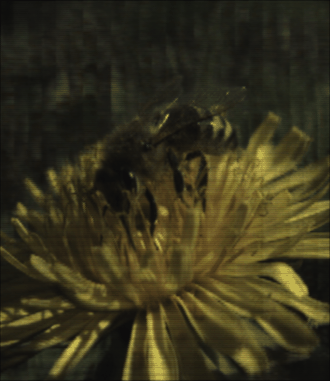

In [ ]:
with open('baseline_move_with_histograms_blur.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

Можно видеть, что полоски на картинке стали менее заметны, больше нет проблем с появлением различных (других) цветов на картинке, с другой стороны, чёткость изображения стала хуже (можно увидеть на крылышках).


## Часть 2. Немного 3D (7 баллов)

В этом подзадании требуется получить [анаглифное](https://ru.wikipedia.org/wiki/%D0%90%D0%BD%D0%B0%D0%B3%D0%BB%D0%B8%D1%84) изображение на основе полученных данных. План приблизительно следующий:
* Создайте два изображения с максимальным параллаксом (горизонтальным расстоянием между виртуальными камерами)
* Наложите их друг на друга, используя цветовые фильтры
* Получите ещё больше баллов за небольшой анализ (пробуйте уменьшать/увеличивать параллакс, создаёте gif-картинку). Что будет, если изначально накладывать изображения с небольшим сдвигом?

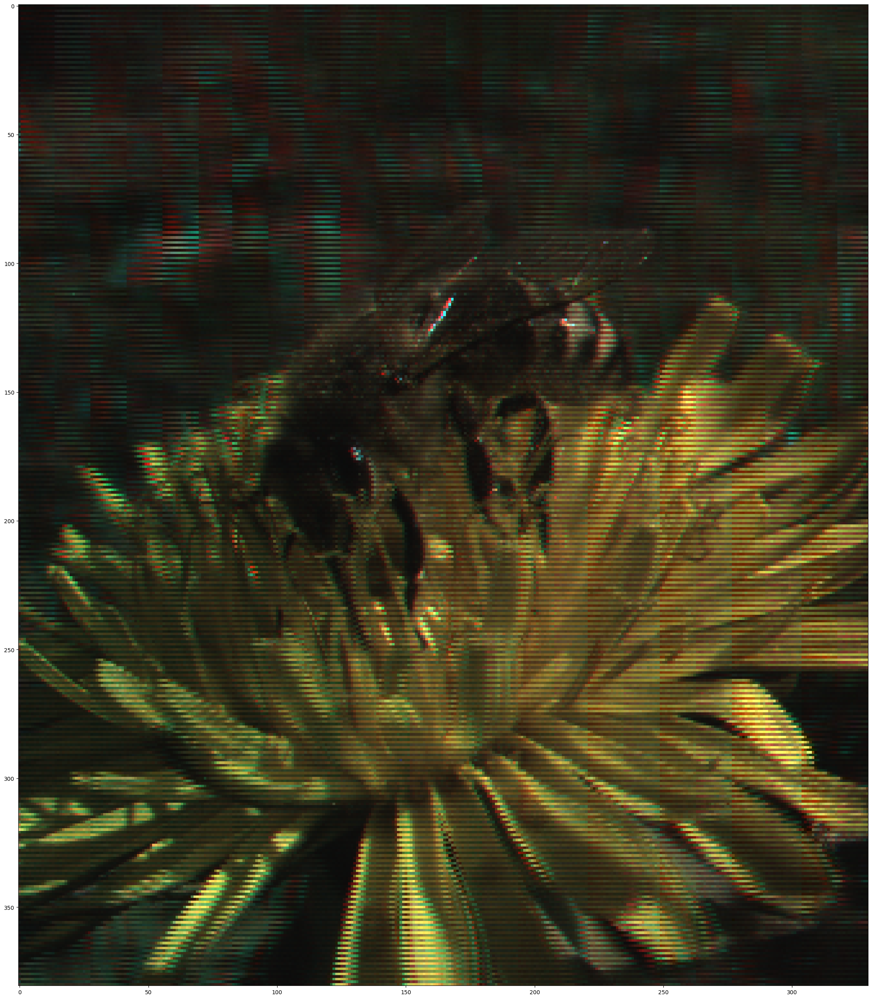

In [ ]:
img = image_interpolated
first = baseline_move_his(image_interpolated, plenoptic_image_config, 0, -4)
second = baseline_move_his(image_interpolated, plenoptic_image_config, 0, 4)
first[..., 0] *= 0
second[..., 1] *= 0
second[..., 2] *= 0
im = (first + second)
plt.figure(figsize=(32, 32))
plt.imshow(im)
plt.show()

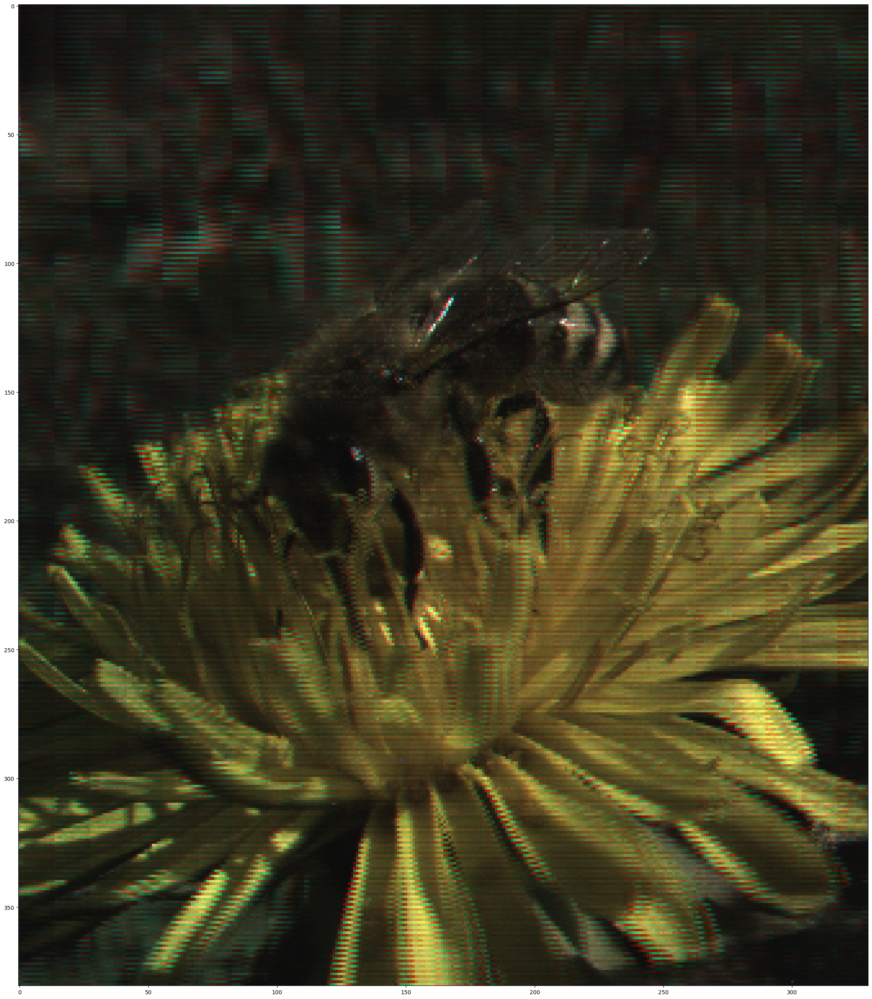

In [ ]:
img = image_interpolated
first = baseline_move_his(image_interpolated, plenoptic_image_config, 0, -3)
second = baseline_move_his(image_interpolated, plenoptic_image_config, 0, 3)
first[..., 0] *= 0
second[..., 1] *= 0
second[..., 2] *= 0
im = (first + second)
plt.figure(figsize=(32, 32))
plt.imshow(im)
plt.show()

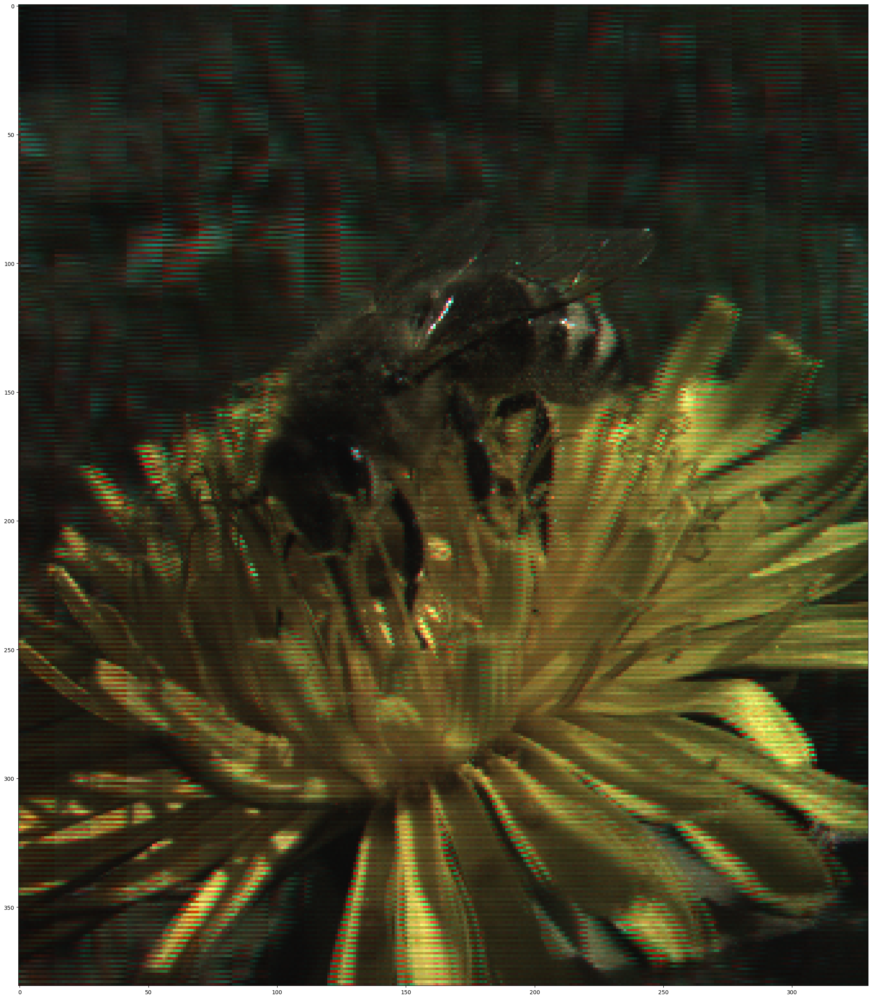

In [ ]:
img = image_interpolated
first = baseline_move_his(image_interpolated, plenoptic_image_config, 0, -2)
second = baseline_move_his(image_interpolated, plenoptic_image_config, 0, 2)
first[..., 0] *= 0
second[..., 1] *= 0
second[..., 2] *= 0
im = (first + second)
plt.figure(figsize=(32, 32))
plt.imshow(im)
plt.show()

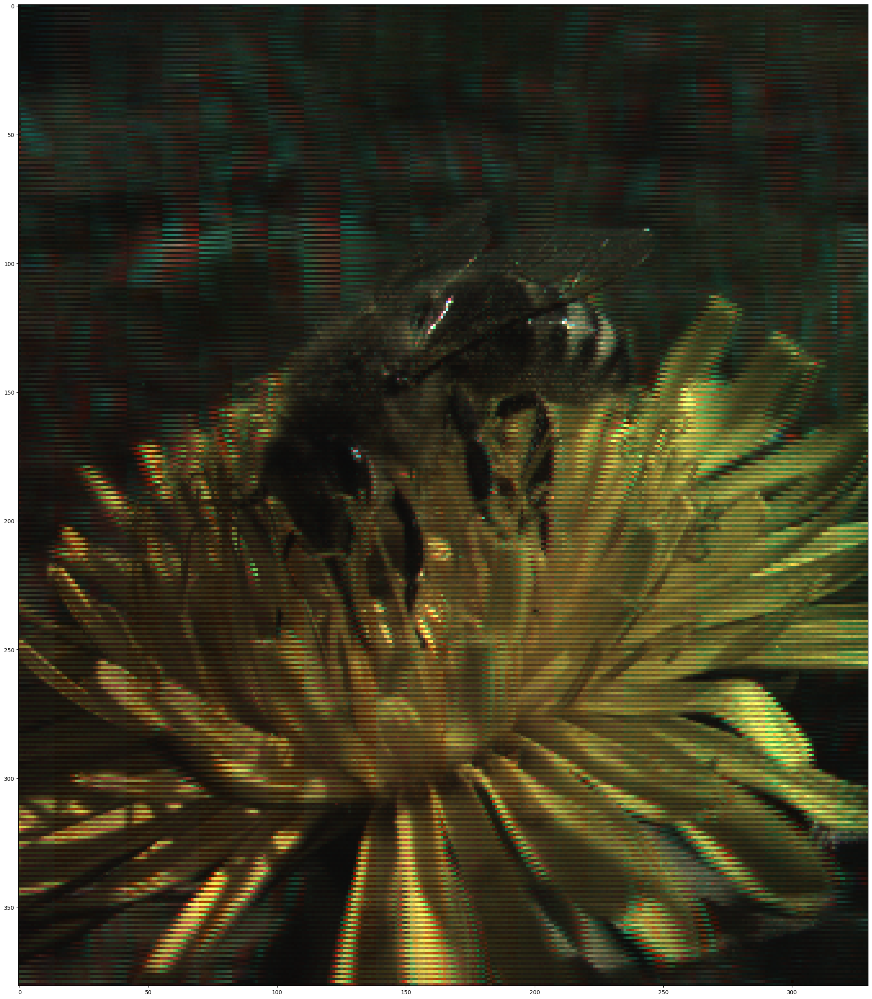

In [ ]:
img = image_interpolated
first = baseline_move_his(image_interpolated, plenoptic_image_config, 0, -1)
second = baseline_move_his(image_interpolated, plenoptic_image_config, 0, 1)
first[..., 0] *= 0
second[..., 1] *= 0
second[..., 2] *= 0
im = (first + second)
plt.figure(figsize=(32, 32))
plt.imshow(im)
plt.show()

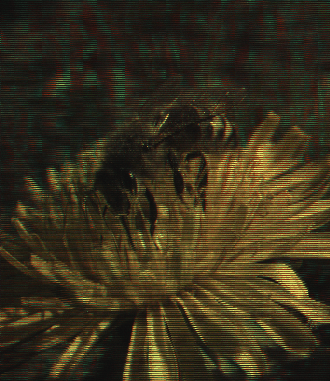

In [ ]:
first = baseline_move_his(image_interpolated, plenoptic_image_config, 0, -4)
second = baseline_move_his(image_interpolated, plenoptic_image_config, 0, 4)
first[..., 0] *= 0
second[..., 1] *= 0
second[..., 2] *= 0
new_image = first + second
images = []
for i in range(-3, 5):
    first = baseline_move_his(image_interpolated, plenoptic_image_config, i, -4)
    second = baseline_move_his(image_interpolated, plenoptic_image_config, i, 4)
    first[..., 0] *= 0
    second[..., 1] *= 0
    second[..., 2] *= 0
    image = first + second
    image = match_histograms(image, new_image)
    images.append(image)

output_file='baseline_move_with_last_5.gif'
duration = 0.11
imageio.mimsave(output_file, images, duration=duration)

with open('baseline_move_with_last_5.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

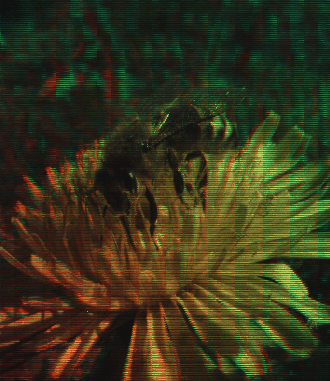

In [ ]:
first = baseline_move_his(image_interpolated, plenoptic_image_config, 0, -3)
second = baseline_move_his(image_interpolated, plenoptic_image_config, 0, 3)
first[..., 0] *= 0
second[..., 1] *= 0
second[..., 2] *= 0
new_image = first + second
images = []
for i in range(-3, 5):
    first = baseline_move_his(image_interpolated, plenoptic_image_config, i, -3)
    second = baseline_move_his(image_interpolated, plenoptic_image_config, i, 3)
    first[..., 0] *= 0
    second[..., 1] *= 0
    second[..., 2] *= 0
    image = first + second
    image = match_histograms(image, new_image)
    images.append(image)

output_file='baseline_move_with_last_6.gif'
duration = 0.11
imageio.mimsave(output_file, images, duration=duration)

with open('baseline_move_with_last_6.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

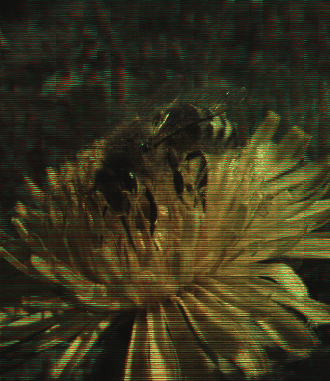

In [ ]:
first = baseline_move_his(image_interpolated, plenoptic_image_config, 0, -2)
second = baseline_move_his(image_interpolated, plenoptic_image_config, 0, 2)
first[..., 0] *= 0
second[..., 1] *= 0
second[..., 2] *= 0
new_image = first + second
images = []
for i in range(-3, 5):
    first = baseline_move_his(image_interpolated, plenoptic_image_config, i, -2)
    second = baseline_move_his(image_interpolated, plenoptic_image_config, i, 2)
    first[..., 0] *= 0
    second[..., 1] *= 0
    second[..., 2] *= 0
    image = first + second
    image = match_histograms(image, new_image)
    images.append(image)

output_file='baseline_move_with_last_7.gif'
duration = 0.11
imageio.mimsave(output_file, images, duration=duration)

with open('baseline_move_with_last_7.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

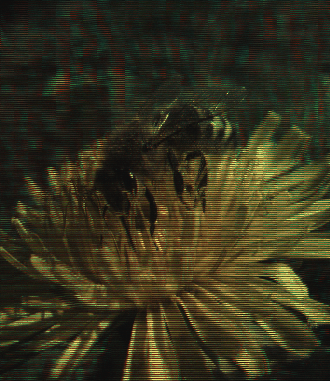

In [ ]:
first = baseline_move_his(image_interpolated, plenoptic_image_config, 0, -1)
second = baseline_move_his(image_interpolated, plenoptic_image_config, 0, 1)
first[..., 0] *= 0
second[..., 1] *= 0
second[..., 2] *= 0
new_image = first + second
images = []
for i in range(-3, 5):
    first = baseline_move_his(image_interpolated, plenoptic_image_config, i, -1)
    second = baseline_move_his(image_interpolated, plenoptic_image_config, i, 1)
    first[..., 0] *= 0
    second[..., 1] *= 0
    second[..., 2] *= 0
    image = first + second
    image = match_histograms(image, new_image)
    images.append(image)

output_file='baseline_move_with_last_8.gif'
duration = 0.11
imageio.mimsave(output_file, images, duration=duration)

with open('baseline_move_with_last_8.gif','rb') as f:
    display(ImageDisplay(data=f.read(), format='gif'))

Чем больше параллакс межжду картинками, тем больше можно видить в картинке цветов, присущих только одному "глазу" (голубой / красный).

## The end?

![dear_princess_celestia.jpg](dear_princess_celestia.jpg)

*Пожалуйста, напишите ниже в свободной форме вашу боль от задания: что понравилось, что не понравилось*

Было интересно создавать 4D картинку, правильно обходить края (для более приятного вида), возиться с фильтрами (писал сам, выбрал наилучший из своих).
Трудно понять, зачем вообще были нужны маски цветов (в итоге осознал, но сделал задание не испоьзуя их). Изначально создавал интерполированную картинку по расстановке цветов из википелии, оказалось, что сетка цветов там и в задании разная, провозился день, пока не понял эту ошибку.